In [108]:
# !pip install plotly

In [109]:
import pandas as pd
import numpy as np
import plotly.express as px

## Importando arquivos necessários










In [110]:
churn = pd.read_csv('arquivos originais/churn.csv')

In [111]:
commentInteractions = pd.read_csv('arquivos originais/commentInteractions.csv')

C:\Users\MATHEU~1.SCH\AppData\Local\Temp/ipykernel_4680/2751135352.py:1: DtypeWarning:

Columns (2,3) have mixed types. Specify dtype option on import or set low_memory=False.



In [112]:
comments_clean_anonimized = pd.read_csv('arquivos originais/comments_clean_anonimized.csv')

In [113]:
votes = pd.read_csv('arquivos originais/votes.csv')

## Entenda seu Dado

- <b>Arquivo de churn</b>:
Descreve se o funcionário ainda está na empresa, indicando os que já sairam (<i>churn</i>). Ignorar ids negativos, o id do funcionário é único dentro da empresa somente (funcionários distintos em empresas diferentes podem ter o mesmo ID).
Arquivo: data/churn.csv

In [114]:
churn.head()

,employee,companyAlias,numVotes,lastParticipationDate,stillExists
0,512,56aec740f1ef260003e307d6,4,Thu Feb 23 12:48:04 CET 2017,True
1,-2,56aec740f1ef260003e307d6,0,Wed Jan 18 14:00:55 CET 2017,False
2,2,56aec740f1ef260003e307d6,72,Fri Mar 17 01:00:00 CET 2017,True
3,487,56aec740f1ef260003e307d6,14,Sat Nov 19 15:02:14 CET 2016,False
4,3,56aec740f1ef260003e307d6,22,Thu Feb 16 01:00:00 CET 2017,True


- <b>Arquivo de Interação nos Comentários</b>:
Descreve os usuário que interagiram com os comentários postados, dando like ou deslike. Arquivo: data/commentInteractions.csv

In [115]:
commentInteractions.head()

,employee,companyAlias,liked,disliked,commentId
0,307,56aec740f1ef260003e307d6,True,False,58d018d7e010990004e38070
1,36,56aec740f1ef260003e307d6,True,False,58d018d7e010990004e38070
2,276,56aec740f1ef260003e307d6,True,False,58d018d7e010990004e38070
3,24,56aec740f1ef260003e307d6,True,False,58d018d7e010990004e38070
4,382,56aec740f1ef260003e307d6,True,False,58d0179ae010990004e3806d


- <b>Arquivo de Comentários Anônimos</b>:
Descreve cada comentário escrito pelos funcionários e uma visão geral da quantidade de likes e deslikes. Arquivo: data/comments_clean_anonimized.csv

In [116]:
comments_clean_anonimized.head()

,employee,companyAlias,commentId,txt,likes,dislikes,commentDate
0,307,56aec740f1ef260003e307d6,58d018d7e010990004e38070,**********************************************...,4.0,0.0,Mon Mar 20 19:00:17 CET 2017
1,382,56aec740f1ef260003e307d6,58d0179ae010990004e3806d,*****************************,1.0,2.0,Mon Mar 20 18:55:16 CET 2017
2,172,56aec740f1ef260003e307d6,58cff8cde010990004e37f6a,***************************,3.0,0.0,Mon Mar 20 16:44:02 CET 2017
3,135,56aec740f1ef260003e307d6,58cfefeee010990004e37f60,***************************,1.0,1.0,Mon Mar 20 16:06:08 CET 2017
4,225,56aec740f1ef260003e307d6,58cfd9b4e010990004e37f52,*********************************,3.0,2.0,Mon Mar 20 14:30:50 CET 2017


- <b>Arquivo de Votação</b>: 
Representa os votos do funcionário na pesquisa de statisfação, sendo que cada voto mede a felicidade de 1 a 4, sendo 4 o mais feliz. Arquivo: data/votes.csv

In [117]:
votes.head()

,employee,companyAlias,voteDate,vote
0,31,56aec740f1ef260003e307d6,Mon Feb 01 01:00:00 CET 2016,4
1,33,56aec740f1ef260003e307d6,Mon Feb 01 01:00:00 CET 2016,4
2,79,56aec740f1ef260003e307d6,Mon Feb 01 01:00:00 CET 2016,4
3,94,56aec740f1ef260003e307d6,Mon Feb 01 01:00:00 CET 2016,4
4,16,56aec740f1ef260003e307d6,Mon Feb 01 01:00:00 CET 2016,2


# Entendendo os Dados



a) Qual a sua variável target?

lastParticipationDate e stillExists

In [118]:
churn.lastParticipationDate

0        Thu Feb 23 12:48:04 CET 2017
1        Wed Jan 18 14:00:55 CET 2017
2        Fri Mar 17 01:00:00 CET 2017
3        Sat Nov 19 15:02:14 CET 2016
4        Thu Feb 16 01:00:00 CET 2017
                    ...              
4842     Fri Mar 17 15:43:58 CET 2017
4843     Fri Mar 17 17:00:00 CET 2017
4844     Fri Mar 17 17:01:54 CET 2017
4845    Tue Jun 28 02:00:00 CEST 2016
4846    Mon Jul 04 19:02:03 CEST 2016
Name: lastParticipationDate, Length: 4847, dtype: object

In [119]:
churn.stillExists

0        True
1       False
2        True
3       False
4        True
        ...  
4842     True
4843     True
4844     True
4845     True
4846     True
Name: stillExists, Length: 4847, dtype: bool

b) Quais as colunas do seu dataset que podem te ajudar a prever isso?

(dataset x Colunas)

- Churn
  - numVotes
- comment_interactions
  - like
  - <font color=green>flag funcionário deu like em comentario xyz?</font>
- comments_clean_anonimized
  - <s>employee</s>
  - likes
  - deslikes
  - <font color=red>qt dias entre comentário e churn</font>
- votes
  - <s>employee</s>
  - vote
  - <font color=red>Há quanto tempo ele deu esta nota?</font>




c) Existem outras informações (talvez na internet) que poderiam te ajudar a prever?

- preço da ação da companhia
- média de avaliação da companhia em sites de empresa
- número de funcionários da companhia no linked_in

d) Como os datasets se relacionam?


- churn
  -   commentInteractions = employee
  -   comments_clean_anonimized = companyAlias | employee
  -   votes = companyAlias | employee
- commentInteractions
  - comments_clean_anonimized = commentId | companyAlias | employee
  - votes = companyAlias | employee
- comments_clean_anonimized
  - votes = companyAlias | employee



e) Filtre o comentário de id "58cff8cde010990004e37f6a" nas bases comment_interactions e comments_clean_anonimized. Qual a diferença?

R: A diferença das linhas ocorre por conta das duas bases possuírem "ações" diferentes. Enquanto a **commentIntereactions** armazena os likes dos comentários, a segunda base armezena os comentários em sí. 

POdemos ver que a segunda base possui dados duplicados.

In [120]:
commentInteractions[commentInteractions.commentId == '58cff8cde010990004e37f6a']

,employee,companyAlias,liked,disliked,commentId
7,164,56aec740f1ef260003e307d6,True,False,58cff8cde010990004e37f6a
8,34,56aec740f1ef260003e307d6,True,False,58cff8cde010990004e37f6a
9,152,56aec740f1ef260003e307d6,True,False,58cff8cde010990004e37f6a


In [121]:
comments_clean_anonimized[comments_clean_anonimized.commentId == '58cff8cde010990004e37f6a']

,employee,companyAlias,commentId,txt,likes,dislikes,commentDate
2,172,56aec740f1ef260003e307d6,58cff8cde010990004e37f6a,***************************,3.0,0.0,Mon Mar 20 16:44:02 CET 2017
5115,172,56aec740f1ef260003e307d6,58cff8cde010990004e37f6a,***************************,3.0,0.0,Mon Mar 20 16:44:02 CET 2017


# Analise Seu dado

a) Qual o tipo de variável que você tem?

churn:

- employee: Tipo Indefinido (apesar de ser um Int, é uma chave sem significado)
- companyAlias: Tipo Indefinido
- numVotes: Contagem
- lastParticipationDate: Temporal
- stillExists: Binário (Bool)



In [122]:
churn.dtypes

employee                  int64
companyAlias             object
numVotes                  int64
lastParticipationDate    object
stillExists                bool
dtype: object

In [123]:
churn.head(1)

,employee,companyAlias,numVotes,lastParticipationDate,stillExists
0,512,56aec740f1ef260003e307d6,4,Thu Feb 23 12:48:04 CET 2017,True


votes:
- employee: Indefinido
- companyAlias: Indefinido
- voteDate: Temporal
- vote: Contagem

In [124]:
votes.dtypes

employee         int64
companyAlias    object
voteDate        object
vote             int64
dtype: object

In [125]:
votes.head(1)

,employee,companyAlias,voteDate,vote
0,31,56aec740f1ef260003e307d6,Mon Feb 01 01:00:00 CET 2016,4


comments_clean_anonimized:
- employee: Indefinido
- companyAlias: Indefinido
- commentId: Indefinido
- txt: Texto livre (Nominal Não-Categórico) -> Precisa de transformação!
- likes: contagem
- dislikes: Contagem
- commentDate: Temporal

In [126]:
comments_clean_anonimized.head(1)

,employee,companyAlias,commentId,txt,likes,dislikes,commentDate
0,307,56aec740f1ef260003e307d6,58d018d7e010990004e38070,**********************************************...,4.0,0.0,Mon Mar 20 19:00:17 CET 2017


commentInteractions:

- employee: Indefinido
- companyAlias: Indefinido
- commentId: Indefinido
- liked: booleano
- disliked: booleano

In [127]:
commentInteractions.head(1)

,employee,companyAlias,liked,disliked,commentId
0,307,56aec740f1ef260003e307d6,True,False,58d018d7e010990004e38070




b) Existe alguma conversão de tipo que precisa ser feita (string para datas / float para int / etc.)? Aproveite esse momento para realizar as conversões necessárias de modo que a gente consiga analisar as faixas de valor dos dados de forma apropriada.

Dica 1: para as datas, consulte https://docs.python.org/3/library/datetime.html#strftime-and-strptime-format-codes .

Dica 2: nesse dataset, as datas estão na timezone CET e algumas no horário de verão (CEST). Como o Pandas não reconhece o formato CEST, sugiro substituir o CEST por EET, um outro fuso com a mesma quantidade de horas de diferença.

Dica 3: após a conversão usando o pd.to_datetime(), aplique o mapping .map(lambda x: x.tz_convert(None)) para converter para a timezone UTC (padrão). Isso evitará erros na frente.

## Tratando Datas

In [128]:
pd.to_datetime("Mon Mar 20 19:00:17 EET 2017", format="%a %b %d %X %Z %Y").tz_convert(None)

Timestamp('2017-03-20 17:00:17')

In [129]:
churn.lastParticipationDate.iloc[4846]

'Mon Jul 04 19:02:03 CEST 2016'

In [130]:
churn.lastParticipationDate = churn.lastParticipationDate.astype(str).map(lambda x: x.replace('CEST','EET'))

In [131]:
churn.lastParticipationDate.iloc[4846]

'Mon Jul 04 19:02:03 EET 2016'

In [132]:
votes.voteDate = votes.voteDate.astype(str).map(lambda x: x.replace('CEST','EET'))

In [133]:
comments_clean_anonimized.commentDate = comments_clean_anonimized.commentDate.astype(str).map(lambda x: x.replace('CEST','EET'))

In [134]:
pd.to_datetime(churn.lastParticipationDate, format="%a %b %d %X %Z %Y").map( lambda x: x.tz_convert(None))

0      2017-02-23 11:48:04
1      2017-01-18 13:00:55
2      2017-03-17 00:00:00
3      2016-11-19 14:02:14
4      2017-02-16 00:00:00
               ...        
4842   2017-03-17 14:43:58
4843   2017-03-17 16:00:00
4844   2017-03-17 16:01:54
4845   2016-06-27 23:00:00
4846   2016-07-04 16:02:03
Name: lastParticipationDate, Length: 4847, dtype: datetime64[ns]

In [135]:
churn.lastParticipationDate = pd.to_datetime(churn.lastParticipationDate, format="%a %b %d %X %Z %Y").map( lambda x: x.tz_convert(None))
votes.voteDate  = pd.to_datetime(votes.voteDate , format="%a %b %d %X %Z %Y").map(lambda x: x.tz_convert(None))
comments_clean_anonimized.commentDate = pd.to_datetime(comments_clean_anonimized.commentDate, format="%a %b %d %X %Z %Y").map(lambda x: x.tz_convert(None))

## Tratando Booleanos

In [136]:
def bool2int(df):
    bool_cols = df.select_dtypes('bool').columns
    for col in bool_cols:
        df[col] = df[col].map(lambda x: 1 if x is True else 0)
    return df

In [137]:
churn = bool2int(churn)

In [138]:
votes = bool2int(votes)

In [139]:
commentInteractions.liked = commentInteractions.liked.map(bool)
commentInteractions.disliked = commentInteractions.disliked.map(bool)

commentInteractions = bool2int(commentInteractions)

In [140]:
commentInteractions.head()

,employee,companyAlias,liked,disliked,commentId
0,307,56aec740f1ef260003e307d6,1,0,58d018d7e010990004e38070
1,36,56aec740f1ef260003e307d6,1,0,58d018d7e010990004e38070
2,276,56aec740f1ef260003e307d6,1,0,58d018d7e010990004e38070
3,24,56aec740f1ef260003e307d6,1,0,58d018d7e010990004e38070
4,382,56aec740f1ef260003e307d6,1,0,58d0179ae010990004e3806d


In [141]:
comments_clean_anonimized = bool2int(comments_clean_anonimized)

b) Qual a faixa de valores de cada uma delas?

In [142]:
churn.describe()

,employee,numVotes,stillExists
count,4847.000000,4847.000000,4847.000000
mean,167.375490,45.896431,0.757788
std,208.271041,71.302128,0.428466
min,-218.000000,0.000000,0.000000
25%,33.000000,3.000000,1.000000
50%,113.000000,16.000000,1.000000
75%,231.000000,59.000000,1.000000
max,999.000000,740.000000,1.000000


In [143]:
churn.shape

(4847, 5)

In [144]:
# Exclui os employees negativos
churn = churn.loc[churn.employee>=0]
votes = votes.loc[votes.employee>=0]
commentInteractions = commentInteractions.loc[commentInteractions.employee>=0]
comments_clean_anonimized = comments_clean_anonimized.loc[comments_clean_anonimized.employee>=0]

In [145]:
churn.shape

(4418, 5)

In [146]:
churn.companyAlias.nunique()

37

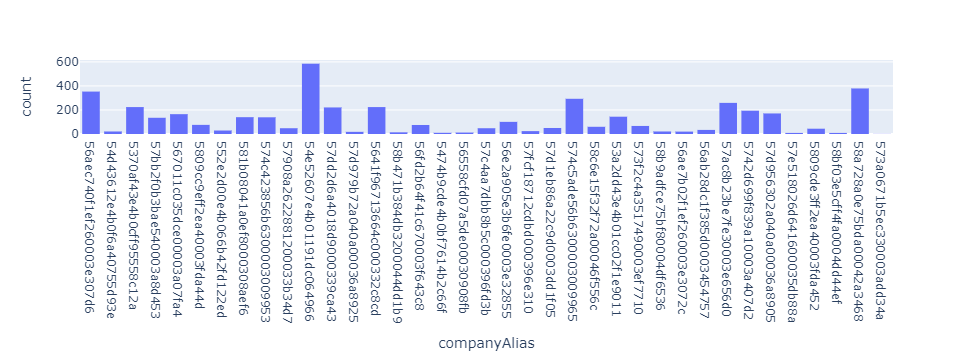

In [147]:
#Observando a distribuição das categorias de companyAlias
fig = px.histogram(churn, x="companyAlias")
fig.show()

In [148]:
churn.lastParticipationDate.describe()

C:\Users\MATHEU~1.SCH\AppData\Local\Temp/ipykernel_4680/2163768675.py:1: FutureWarning:

Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.



count                    4418
unique                   1484
top       2017-03-20 00:00:00
freq                      478
first     2014-06-06 23:00:00
last      2017-03-20 20:25:54
Name: lastParticipationDate, dtype: object

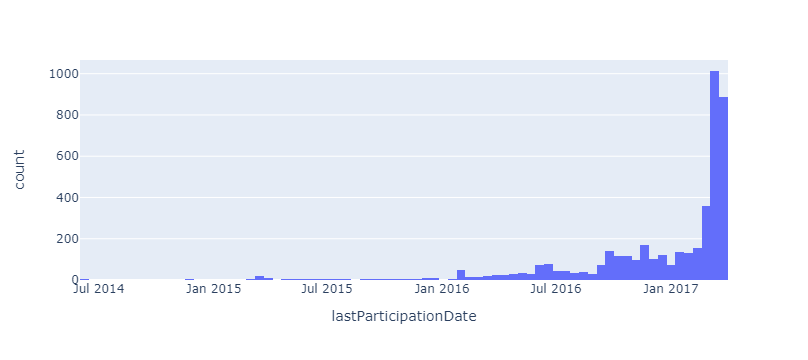

In [149]:
fig = px.histogram(churn, x="lastParticipationDate")
fig.show()

array([[<AxesSubplot:title={'center':'numVotes'}>]], dtype=object)

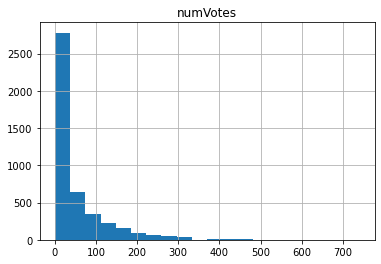

In [150]:
churn[['numVotes']].hist(bins=20)

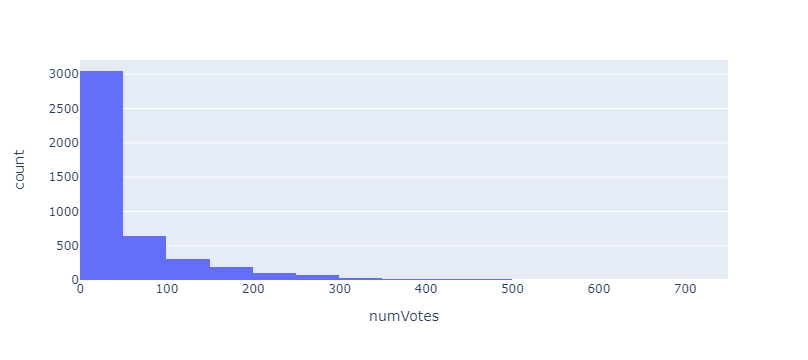

In [151]:
fig = px.histogram(churn, x="numVotes", nbins=20)
fig.show()

In [152]:
churn.groupby('numVotes').count().head(10).companyAlias.sum()

1559

In [153]:
votes.describe()

,employee,vote
count,221232.000000,221232.000000
mean,172.119562,2.861530
std,172.723491,0.986078
min,1.000000,1.000000
25%,50.000000,2.000000
50%,127.000000,3.000000
75%,222.000000,4.000000
max,999.000000,4.000000


In [154]:
votes.vote=votes.vote.map(int)

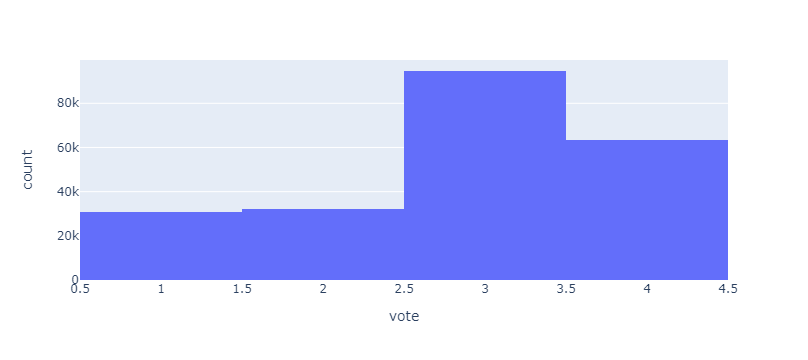

In [155]:
fig = px.histogram(votes, x="vote")
fig.show()

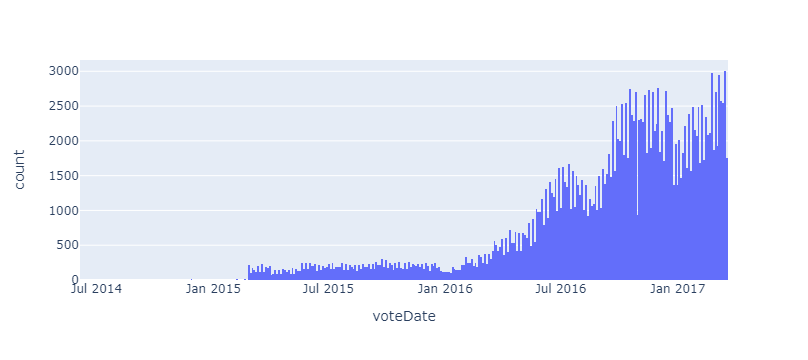

In [156]:
# Using plotly.express
fig = px.histogram(votes, x="voteDate")
fig.show()

In [157]:
comments_clean_anonimized.describe()

,employee,likes,dislikes
count,77329.000000,77328.000000,77328.000000
mean,149.698095,6.994090,1.289093
std,156.121014,7.764383,2.734520
min,1.000000,0.000000,0.000000
25%,38.000000,2.000000,0.000000
50%,112.000000,4.000000,0.000000
75%,206.000000,9.000000,1.000000
max,999.000000,86.000000,53.000000


array([[<AxesSubplot:title={'center':'likes'}>]], dtype=object)

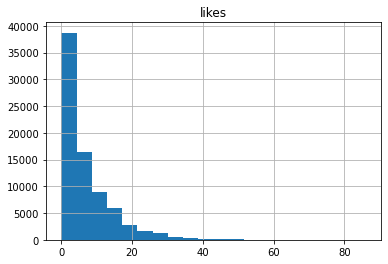

In [158]:
comments_clean_anonimized[['likes']].hist(bins=20)

array([[<AxesSubplot:title={'center':'dislikes'}>]], dtype=object)

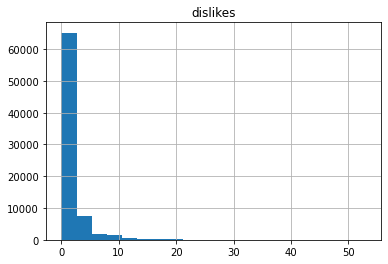

In [159]:
comments_clean_anonimized[['dislikes']].hist(bins=20)

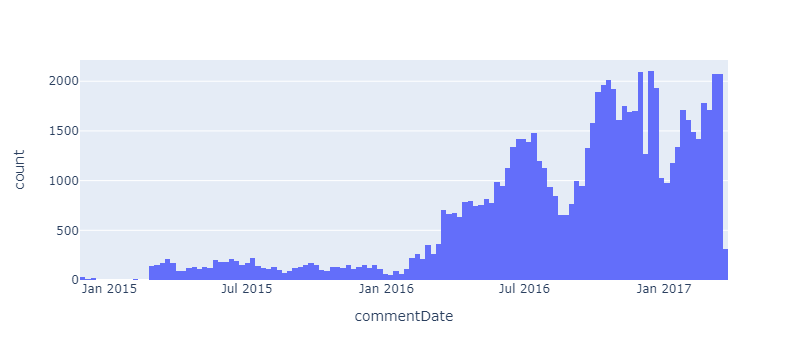

In [160]:
# Using plotly.express
fig = px.histogram(comments_clean_anonimized, x="commentDate")
fig.show()

e) Existem registros duplicados em alguma base (use o .drop_duplicates())? Se houver, elimine-os.

In [161]:
votes.shape

(221232, 4)

In [162]:
votes = votes.drop_duplicates()
votes.shape

(221145, 4)

In [163]:
comments_clean_anonimized = comments_clean_anonimized.drop_duplicates()
comments_clean_anonimized.shape

(38994, 7)

In [164]:
commentInteractions.shape

(324478, 5)

In [165]:
commentInteractions = commentInteractions.drop_duplicates()
commentInteractions.shape

(324471, 5)

# Estruturando

Precisamos gerar uma base final com a estrtutura da churn, que cada registro é representado unicamente por cada employee e company.
Vamos começar adaptando a base votes para essa estrutura. 

a) Precisaremos agregar a base votes por employee, company. Para isso, podemos criar métricas agregadas das variáveis vote e voteDate. 

Todavia, a variável voteDate ainda não está no formato de intervalo temporal. Para isso vamos precisar calcular a diferença dela para o nosso referencial (o lastParticipationDate), que se encontra na base churn.

Junte (merge) os datasets a seguir por meio de suas chaves, criando esse novos dataset:
- votes com churn (trazer somente a coluna lastParticipationDate) -> votes_merge

In [166]:
votes_merge = churn[['employee', 'companyAlias', 'lastParticipationDate']].merge(votes,on=['employee', 'companyAlias'],how="left")
votes_merge.head()

,employee,companyAlias,lastParticipationDate,voteDate,vote
0,512,56aec740f1ef260003e307d6,2017-02-23 11:48:04,2017-01-17,3
1,512,56aec740f1ef260003e307d6,2017-02-23 11:48:04,2017-01-23,2
2,512,56aec740f1ef260003e307d6,2017-02-23 11:48:04,2017-02-21,1
3,512,56aec740f1ef260003e307d6,2017-02-23 11:48:04,2017-02-23,4
4,2,56aec740f1ef260003e307d6,2017-03-17 00:00:00,2016-02-05,2


b) Agora crie a variável qt_dias_diff_vote que represente a quantidade de dias de diferença entre voteDate e lastParticipationDate.

**Observação:**
Se houver dados negativos, significam datas futuras.

In [167]:
churn.dtypes

employee                          int64
companyAlias                     object
numVotes                          int64
lastParticipationDate    datetime64[ns]
stillExists                       int64
dtype: object

In [168]:
votes_merge['qt_dias_diff_vote'] = (votes_merge.lastParticipationDate - votes_merge.voteDate).map(lambda x: x.components.days)

In [169]:
votes_merge['qt_dias_diff_vote'].describe()

count    222883.000000
mean        145.036266
std         135.848875
min        -179.000000
25%          45.000000
50%         112.000000
75%         200.000000
max         770.000000
Name: qt_dias_diff_vote, dtype: float64

c) Veja quantos valores não-positivos existem na variável qt_dias_diff_vote e remova-os da base. Não podemos usar no modelo nenhuma informação que seja futura à nossa variável target (stillExists, mensurada após o lastParticipationDate)

In [170]:
votes_merge[votes_merge['qt_dias_diff_vote']<=0].shape

(4548, 6)

In [171]:
votes_merge = votes_merge[votes_merge['qt_dias_diff_vote']>0]

In [172]:
votes_merge.shape

(218335, 6)

In [173]:
votes_merge.head()

,employee,companyAlias,lastParticipationDate,voteDate,vote,qt_dias_diff_vote
0,512,56aec740f1ef260003e307d6,2017-02-23 11:48:04,2017-01-17,3,37
1,512,56aec740f1ef260003e307d6,2017-02-23 11:48:04,2017-01-23,2,31
2,512,56aec740f1ef260003e307d6,2017-02-23 11:48:04,2017-02-21,1,2
4,2,56aec740f1ef260003e307d6,2017-03-17 00:00:00,2016-02-05,2,406
5,2,56aec740f1ef260003e307d6,2017-03-17 00:00:00,2016-02-08,1,403


d) Agora vamos agrupar a nossa base por <employee, companyAlias> e derivar as seguintes métricas:
- vote: mean, mode (use a função abaixo), min, max, count
- qt_dias_diff_vote: min, max, median

    Chame essa nova base de votes_group. Lembre de dar um flat no nome das colunas.

In [174]:
def mode(x):
    return pd.Series.mode(x)[0]

In [175]:
votes_group = votes_merge.groupby(by=["employee", "companyAlias"], as_index=False).agg({
    'vote': ['mean', mode, 'min', 'max', 'count'],
    'qt_dias_diff_vote': ['min', 'max', 'median']
})
votes_group.head()

employee              companyAlias      vote                     \
                                          mean mode min max count   
0        1  5474b9cde4b0bf7614b2c66f  4.000000    4   4   4     1   
1        1  54d43612e4b0f6a40755d93e  3.133333    3   2   4    15   
2        1  54e52607e4b01191dc064966  2.984962    3   1   4   133   
3        1  5641f96713664c000332c8cd  3.167969    3   1   4   256   
4        1  56558cfd07a5de00030908fb  3.000000    3   3   3     1   

  qt_dias_diff_vote              
                min  max median  
0                 1    1    1.0  
1                13  487   35.0  
2                 2  553  230.0  
3                 1  325  147.5  
4                 4    4    4.0

In [176]:
votes_group.columns = ['_'.join(col).strip() if col[1] != "" else col[0] for col in votes_group.columns.values]

In [177]:
votes_group.head()

,employee,companyAlias,vote_mean,vote_mode,vote_min,vote_max,vote_count,qt_dias_diff_vote_min,qt_dias_diff_vote_max,qt_dias_diff_vote_median
0,1,5474b9cde4b0bf7614b2c66f,4.000000,4,4,4,1,1,1,1.0
1,1,54d43612e4b0f6a40755d93e,3.133333,3,2,4,15,13,487,35.0
2,1,54e52607e4b01191dc064966,2.984962,3,1,4,133,2,553,230.0
3,1,5641f96713664c000332c8cd,3.167969,3,1,4,256,1,325,147.5
4,1,56558cfd07a5de00030908fb,3.000000,3,3,3,1,4,4,4.0


In [178]:
votes_group.shape

(3919, 10)

In [179]:
votes_group.isnull().sum()

employee                    0
companyAlias                0
vote_mean                   0
vote_mode                   0
vote_min                    0
vote_max                    0
vote_count                  0
qt_dias_diff_vote_min       0
qt_dias_diff_vote_max       0
qt_dias_diff_vote_median    0
dtype: int64

e) Agora vamos estruturar nossa base de comentários. Na parte 1 do nosso case, vamos ignorar a base de interações dos comentários e deixar ela para a parte 2.

Essa base possui a variável commentDate, que ainda não está no formato de intervalo temporal. Para isso também vamos precisar calcular a diferença dela para o nosso referencial (o lastParticipationDate), que se encontra na base churn.

Junte (merge) os datasets a seguir por meio de suas chaves, criando esse novos dataset:
- comments_clean_anonimized com churn (trazer somente a coluna lastParticipationDate) -> df_comments_merge

In [180]:
df_comments_merge = churn[['employee', 'companyAlias', 'lastParticipationDate']].merge(comments_clean_anonimized,on=['employee', 'companyAlias'],how="inner")
df_comments_merge.head()

,employee,companyAlias,lastParticipationDate,commentId,txt,likes,dislikes,commentDate
0,512,56aec740f1ef260003e307d6,2017-02-23 11:48:04,58ac23657b6f5d00046f8b0e,**********************************************...,9.0,0.0,2017-02-21 11:23:01
1,512,56aec740f1ef260003e307d6,2017-02-23 11:48:04,588631dd751222000420e1e8,**********************************************...,6.0,2.0,2017-01-23 16:39:11
2,2,56aec740f1ef260003e307d6,2017-03-17 00:00:00,5891fdcae17cc3000411f911,**********************************************...,12.0,5.0,2017-02-01 15:23:07
3,2,56aec740f1ef260003e307d6,2017-03-17 00:00:00,5852a04bc8a2da000497c38a,**********************************************...,5.0,12.0,2016-12-15 13:52:25
4,2,56aec740f1ef260003e307d6,2017-03-17 00:00:00,584facca0b45f50004cb1c02,**********************************************...,5.0,9.0,2016-12-13 08:09:10


f) Veja quantos registros nulos há para a variável commentDate, rodando o código abaixo e elimine-os.

In [181]:
df_comments_merge[df_comments_merge.commentDate.isna()]

,employee,companyAlias,lastParticipationDate,commentId,txt,likes,dislikes,commentDate
39169,361,58a728a0e75bda00042a3468,2017-03-17 14:43:58,58adb214b8242400048bf8a6,NaN,NaN,NaN,NaT


In [182]:
df_comments_merge = df_comments_merge[~ df_comments_merge.commentDate.isna()]

g) Agora crie a variável qt_dias_diff_comment que represente a quantidade de dias de diferença entre commentDate e lastParticipationDate.


In [183]:
df_comments_merge['qt_dias_diff_comment'] = (df_comments_merge.lastParticipationDate - df_comments_merge.commentDate).map(lambda x: x.components.days)

In [184]:
df_comments_merge['qt_dias_diff_comment'].describe()

count    39652.000000
mean       150.841496
std        141.298713
min       -110.000000
25%         46.000000
50%        118.000000
75%        215.000000
max        770.000000
Name: qt_dias_diff_comment, dtype: float64

h) Veja quantos valores não-positivos existem na variável qt_dias_diff_comment e remova-os da base. Não podemos usar no modelo nenhuma informação que seja futura à nossa variável target (stillExists, mensurada após o lastParticipationDate)

In [185]:
df_comments_merge[df_comments_merge['qt_dias_diff_comment']<=0].shape

(1068, 9)

In [186]:
df_comments_merge = df_comments_merge[df_comments_merge['qt_dias_diff_comment']>0]

In [187]:
df_comments_merge.shape

(38584, 9)

In [188]:
df_comments_merge.head()

,employee,companyAlias,lastParticipationDate,commentId,txt,likes,dislikes,commentDate,qt_dias_diff_comment
0,512,56aec740f1ef260003e307d6,2017-02-23 11:48:04,58ac23657b6f5d00046f8b0e,**********************************************...,9.0,0.0,2017-02-21 11:23:01,2
1,512,56aec740f1ef260003e307d6,2017-02-23 11:48:04,588631dd751222000420e1e8,**********************************************...,6.0,2.0,2017-01-23 16:39:11,30
2,2,56aec740f1ef260003e307d6,2017-03-17 00:00:00,5891fdcae17cc3000411f911,**********************************************...,12.0,5.0,2017-02-01 15:23:07,43
3,2,56aec740f1ef260003e307d6,2017-03-17 00:00:00,5852a04bc8a2da000497c38a,**********************************************...,5.0,12.0,2016-12-15 13:52:25,91
4,2,56aec740f1ef260003e307d6,2017-03-17 00:00:00,584facca0b45f50004cb1c02,**********************************************...,5.0,9.0,2016-12-13 08:09:10,93


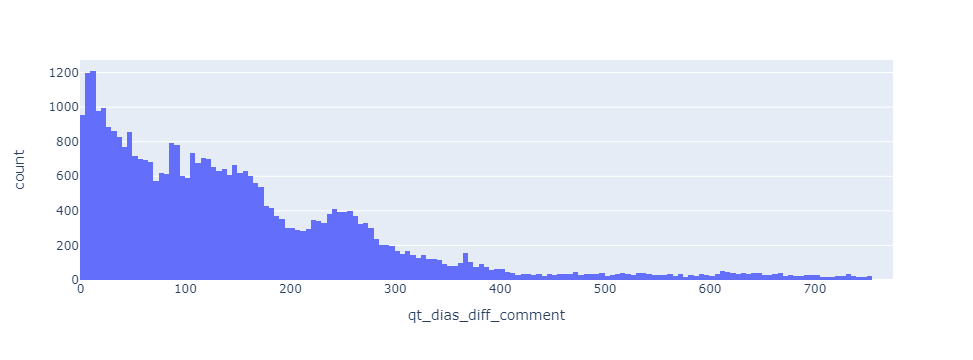

In [189]:
# Using plotly.express
fig = px.histogram(df_comments_merge, x="qt_dias_diff_comment")
fig.show()

i) Agora vamos agrupar a nossa base por <employee, companyAlias> e derivar as seguintes métricas:
- likes: mean, min, max
- dislikes: mean, min, max
- qt_dias_diff_comment: min, max, median
- commentId: count

    Chame essa nova base de df_comments_group. Lembre de dar um flat no nome das colunas.

In [190]:
df_comments_group = df_comments_merge.groupby(by=["employee", "companyAlias"], as_index=False).agg({
    'likes': ['mean','min', 'max'],
    'dislikes': ['mean','min', 'max'],
    'qt_dias_diff_comment': ['min', 'max', 'median'],
    'commentId': ['count']
})
df_comments_group.head()

employee              companyAlias     likes             dislikes       \
                                          mean  min   max      mean  min   
0        1  5641f96713664c000332c8cd  4.371859  0.0  25.0  1.778894  0.0   
1        1  56558cfd07a5de00030908fb  5.000000  5.0   5.0  0.000000  0.0   
2        1  56e2a905e3b6fe0003e32855  6.025000  0.0  13.0  1.475000  0.0   
3        1  5742d699f839a10003a407d2  4.695652  0.0  14.0  0.478261  0.0   
4        1  574c423856b6300003009953  2.763889  0.0  16.0  0.472222  0.0   

        qt_dias_diff_comment             commentId  
    max                  min  max median     count  
0  11.0                   36  311  163.0       199  
1   0.0                    3    3    3.0         1  
2   7.0                  102  369  308.5        40  
3   5.0                  110  301  257.0        23  
4   6.0                    4  272  192.5        72

In [191]:
df_comments_group.columns = ['_'.join(col).strip() if col[1] != "" else col[0] for col in df_comments_group.columns.values]

In [192]:
df_comments_group.head()

,employee,companyAlias,likes_mean,likes_min,likes_max,dislikes_mean,dislikes_min,dislikes_max,qt_dias_diff_comment_min,qt_dias_diff_comment_max,qt_dias_diff_comment_median,commentId_count
0,1,5641f96713664c000332c8cd,4.371859,0.0,25.0,1.778894,0.0,11.0,36,311,163.0,199
1,1,56558cfd07a5de00030908fb,5.000000,5.0,5.0,0.000000,0.0,0.0,3,3,3.0,1
2,1,56e2a905e3b6fe0003e32855,6.025000,0.0,13.0,1.475000,0.0,7.0,102,369,308.5,40
3,1,5742d699f839a10003a407d2,4.695652,0.0,14.0,0.478261,0.0,5.0,110,301,257.0,23
4,1,574c423856b6300003009953,2.763889,0.0,16.0,0.472222,0.0,6.0,4,272,192.5,72


In [193]:
df_comments_group.shape

(2674, 12)

j) Por fim, vamos juntar as 3 bases: churn, votes_group e df_comments_group. Dica: selecione somente as variáveis que você quer levar pro dataset final, deixando as que não serão mais utilizadas.

In [194]:
churn_merge = churn.merge(votes_group,on=['employee', 'companyAlias'],how="left")
churn_merge.head()

,employee,companyAlias,numVotes,lastParticipationDate,stillExists,vote_mean,vote_mode,vote_min,vote_max,vote_count,qt_dias_diff_vote_min,qt_dias_diff_vote_max,qt_dias_diff_vote_median
0,512,56aec740f1ef260003e307d6,4,2017-02-23 11:48:04,1,2.000000,1.0,1.0,3.0,3.0,2.0,37.0,31.0
1,2,56aec740f1ef260003e307d6,72,2017-03-17 00:00:00,1,2.239437,1.0,1.0,4.0,71.0,21.0,406.0,256.0
2,487,56aec740f1ef260003e307d6,14,2016-11-19 14:02:14,0,3.181818,3.0,2.0,4.0,22.0,2.0,66.0,26.5
3,3,56aec740f1ef260003e307d6,22,2017-02-16 00:00:00,1,3.476190,4.0,2.0,4.0,21.0,7.0,378.0,355.0
4,4,56aec740f1ef260003e307d6,195,2017-03-20 00:00:00,1,3.860825,4.0,1.0,4.0,194.0,1.0,368.0,105.5


In [195]:
churn_merge = churn_merge.merge(df_comments_group,on=['employee', 'companyAlias'],how="left")
churn_merge.head()

,employee,companyAlias,numVotes,lastParticipationDate,stillExists,vote_mean,vote_mode,vote_min,vote_max,vote_count,...,likes_mean,likes_min,likes_max,dislikes_mean,dislikes_min,dislikes_max,qt_dias_diff_comment_min,qt_dias_diff_comment_max,qt_dias_diff_comment_median,commentId_count
0,512,56aec740f1ef260003e307d6,4,2017-02-23 11:48:04,1,2.000000,1.0,1.0,3.0,3.0,...,7.500000,6.0,9.0,1.000000,0.0,2.0,2.0,30.0,16.0,2.0
1,2,56aec740f1ef260003e307d6,72,2017-03-17 00:00:00,1,2.239437,1.0,1.0,4.0,71.0,...,5.428571,0.0,12.0,4.785714,0.0,12.0,43.0,399.0,267.0,14.0
2,487,56aec740f1ef260003e307d6,14,2016-11-19 14:02:14,0,3.181818,3.0,2.0,4.0,22.0,...,6.000000,6.0,6.0,0.000000,0.0,0.0,22.0,22.0,22.0,1.0
3,3,56aec740f1ef260003e307d6,22,2017-02-16 00:00:00,1,3.476190,4.0,2.0,4.0,21.0,...,3.333333,0.0,14.0,0.888889,0.0,4.0,6.0,376.0,239.0,9.0
4,4,56aec740f1ef260003e307d6,195,2017-03-20 00:00:00,1,3.860825,4.0,1.0,4.0,194.0,...,7.500000,1.0,29.0,1.000000,0.0,4.0,33.0,271.0,107.0,10.0


In [196]:
churn_merge.shape

(4418, 23)

# Limpeza

Agora que temos um dataset estruturado, precisamos terminar de limpar nossos dados. Já fizemos algumas limpezas as longo do caminho, mas ainda restam outras.

a) Vamos começar fazendo uma seleção do range de data a ser considerado para a análise. Relembre a distribuição da variável lastParticipationDate. Observe que há alguns registros muito antigos e pouco significativos.

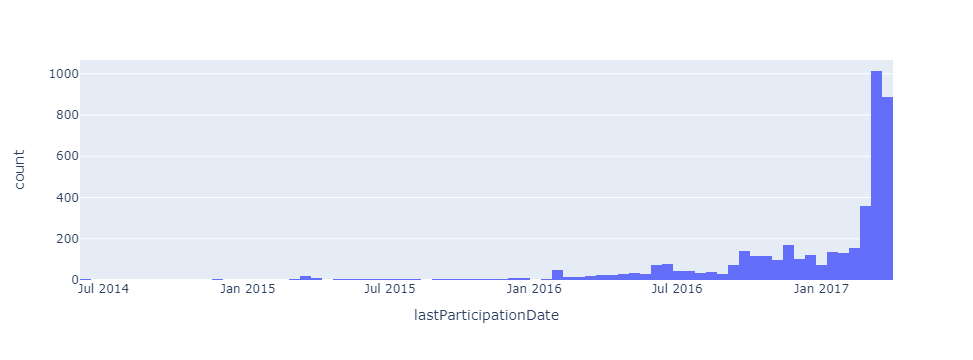

In [197]:
# Using plotly.express
import plotly.express as px

fig = px.histogram(churn_merge, x="lastParticipationDate")
fig.show()

Remova os registros anteriores a Abril de 2016 para considerarmos o histórico de apenas 1 ano. 

In [198]:
churn_merge = churn_merge[churn_merge.lastParticipationDate>='2016-04-01']

In [199]:
churn_merge.shape

(4153, 23)

b) Vamos agora fazer uma análise da quantidade de nulos e decidir como tratar cada um deles. O que você observa?

In [200]:
for col in churn_merge.columns:
    print(churn_merge[col].isna().value_counts())

False    4153
Name: employee, dtype: int64
False    4153
Name: companyAlias, dtype: int64
False    4153
Name: numVotes, dtype: int64
False    4153
Name: lastParticipationDate, dtype: int64
False    4153
Name: stillExists, dtype: int64
False    3772
True      381
Name: vote_mean, dtype: int64
False    3772
True      381
Name: vote_mode, dtype: int64
False    3772
True      381
Name: vote_min, dtype: int64
False    3772
True      381
Name: vote_max, dtype: int64
False    3772
True      381
Name: vote_count, dtype: int64
False    3772
True      381
Name: qt_dias_diff_vote_min, dtype: int64
False    3772
True      381
Name: qt_dias_diff_vote_max, dtype: int64
False    3772
True      381
Name: qt_dias_diff_vote_median, dtype: int64
False    2637
True     1516
Name: likes_mean, dtype: int64
False    2637
True     1516
Name: likes_min, dtype: int64
False    2637
True     1516
Name: likes_max, dtype: int64
False    2637
True     1516
Name: dislikes_mean, dtype: int64
False    2637
True     151

c) É possível notar que para as variáveis que vieram da base de Votação há sempre a mesma quantidade de nulos. Isso significa que os funcionários não participaram da votação. 

As que vieram da base de Comentários também, já que são funcionários que não comentaram. 

Imaginando que após a etapa de Data Wrangling você irá ter que rodar um modelo preditivo de churn que não aceita nulos, como você sugere tratar o nulo em cada um dos casos abaixo? Implemente!

- vote_mean
- vote_mode
- vote_min
- vote_max
- vote_count
- qt_dias_diff_vote_min
- qt_dias_diff_vote_max
- qt_dias_diff_vote_median


- likes_mean
- likes_min
- likes_max
- dislikes_mean
- dislikes_min
- dislikes_max
- qt_dias_diff_comment_min
- qt_dias_diff_comment_max
- qt_dias_diff_comment_median
- commentId_count

OBS: Caso esses dados tivesse que ser mostrados pro cliente ao invés de ir para o modelo, o mais indicado seria calcular os gráficos desconsiderando os registros nulos.

In [201]:
churn_merge.describe()

,employee,numVotes,stillExists,vote_mean,vote_mode,vote_min,vote_max,vote_count,qt_dias_diff_vote_min,qt_dias_diff_vote_max,...,likes_mean,likes_min,likes_max,dislikes_mean,dislikes_min,dislikes_max,qt_dias_diff_comment_min,qt_dias_diff_comment_max,qt_dias_diff_comment_median,commentId_count
count,4153.000000,4153.000000,4153.000000,3772.000000,3772.000000,3772.000000,3772.000000,3772.000000,3772.000000,3772.000000,...,2637.000000,2637.000000,2637.000000,2637.000000,2637.000000,2637.000000,2637.000000,2637.000000,2637.000000,2637.000000
mean,191.590417,52.353239,0.852155,2.944809,2.974284,1.827678,3.746819,57.459173,11.121421,162.085366,...,6.771111,2.311339,15.077361,1.206733,0.238149,4.557072,47.491468,165.327266,117.265264,14.878650
std,204.976034,74.220150,0.354989,0.632418,0.839003,0.909596,0.500122,77.497543,31.202423,154.715582,...,5.787048,4.211471,13.090763,1.849726,1.301983,5.919050,75.673624,147.677514,111.159749,24.947982
min,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
25%,51.000000,6.000000,1.000000,2.636364,3.000000,1.000000,4.000000,8.000000,1.000000,38.000000,...,2.411765,0.000000,5.000000,0.062500,0.000000,1.000000,5.000000,49.000000,33.500000,2.000000
50%,131.000000,21.000000,1.000000,3.000000,3.000000,2.000000,4.000000,25.000000,3.000000,130.000000,...,5.125000,1.000000,12.000000,0.666667,0.000000,2.000000,17.000000,139.000000,94.000000,6.000000
75%,242.000000,70.000000,1.000000,3.333333,4.000000,3.000000,4.000000,76.250000,8.000000,237.000000,...,9.600000,3.000000,22.000000,1.597222,0.000000,6.000000,59.000000,244.000000,162.000000,17.000000
max,999.000000,740.000000,1.000000,4.000000,4.000000,4.000000,4.000000,739.000000,711.000000,770.000000,...,46.000000,46.000000,86.000000,33.000000,33.000000,53.000000,751.000000,770.000000,751.000000,334.000000


<u>Resp:</u>
- vote_mean: pode subsitituir por média geral
- vote_mode: pode subsitituir por moda geral 
- vote_min: pode subsitituir por mediana geral 
- vote_max: pode subsitituir por mediana geral 
- vote_count: pode substituir por 0 porque de fato é 0
- qt_dias_diff_vote_min: pode subsitituir por mediana geral 
- qt_dias_diff_vote_max: pode subsitituir por mediana geral 
- qt_dias_diff_vote_median: pode subsitituir por mediana geral 


- likes_mean: pode subsitituir por média geral
- likes_min: pode subsitituir por mediana geral 
- likes_max: pode subsitituir por mediana geral 
- dislikes_mean: pode subsitituir por média geral
- dislikes_min: pode subsitituir por mediana geral 
- dislikes_max: pode subsitituir por mediana geral 
- qt_dias_diff_comment_min: pode subsitituir por mediana geral
- qt_dias_diff_comment_max: pode subsitituir por mediana geral
- qt_dias_diff_comment_median: pode subsitituir por mediana geral
- commentId_count: pode substituir por 0 porque de fato é 0

In [202]:
mean_cols=['vote_mean','likes_mean', 'dislikes_mean']
for col in mean_cols:
    avg=churn_merge[col].mean()
    churn_merge.loc[churn_merge[col].isna(),col]=avg
    print(col,"- substituição de nulos por",avg)

vote_mean - substituição de nulos por 2.9448091111980603
likes_mean - substituição de nulos por 6.771110578312915
dislikes_mean - substituição de nulos por 1.2067330464720745


In [203]:
median_cols=['vote_mode','vote_max', 'vote_min', 'qt_dias_diff_vote_min', 'qt_dias_diff_vote_max', 'qt_dias_diff_vote_median',
          'likes_min','likes_max','dislikes_min','dislikes_max','qt_dias_diff_comment_min','qt_dias_diff_comment_max',
           'qt_dias_diff_comment_median']
for col in median_cols:
    med=churn_merge[col].median()
    churn_merge.loc[churn_merge[col].isna(),col]=med
    print(col,"- substituição de nulos por",med)

vote_mode - substituição de nulos por 3.0
vote_max - substituição de nulos por 4.0
vote_min - substituição de nulos por 2.0
qt_dias_diff_vote_min - substituição de nulos por 3.0
qt_dias_diff_vote_max - substituição de nulos por 130.0
qt_dias_diff_vote_median - substituição de nulos por 72.5
likes_min - substituição de nulos por 1.0
likes_max - substituição de nulos por 12.0
dislikes_min - substituição de nulos por 0.0
dislikes_max - substituição de nulos por 2.0
qt_dias_diff_comment_min - substituição de nulos por 17.0
qt_dias_diff_comment_max - substituição de nulos por 139.0
qt_dias_diff_comment_median - substituição de nulos por 94.0


d) Para fechar, vamos para a nossa etapa de tratamento de outliers! Rode o describe com os seguintes percentis [0.01,0.1,0.25,0.50,0.75,0.90,0.99].

In [204]:
churn_merge.describe(percentiles=[0.01,0.1,0.25,0.50,0.75,0.90,0.99])

,employee,numVotes,stillExists,vote_mean,vote_mode,vote_min,vote_max,vote_count,qt_dias_diff_vote_min,qt_dias_diff_vote_max,...,likes_mean,likes_min,likes_max,dislikes_mean,dislikes_min,dislikes_max,qt_dias_diff_comment_min,qt_dias_diff_comment_max,qt_dias_diff_comment_median,commentId_count
count,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,3772.000000,4153.000000,4153.000000,...,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,4153.000000,2637.000000
mean,191.590417,52.353239,0.852155,2.944809,2.976643,1.843487,3.770046,57.459173,10.376354,159.141825,...,6.771111,1.832651,13.954009,1.206733,0.151216,3.623646,36.360944,155.716831,108.772574,14.878650
std,204.976034,74.220150,0.354989,0.602703,0.799617,0.868284,0.482196,77.497543,29.828656,147.736892,...,4.611064,3.414546,10.535313,1.473844,1.043726,4.874305,62.057699,118.348870,89.276607,24.947982
min,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
1%,2.000000,1.000000,0.000000,1.142857,1.000000,1.000000,2.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000,3.000000,1.000000
10%,19.000000,2.000000,0.000000,2.121970,2.000000,1.000000,3.000000,3.000000,1.000000,13.000000,...,1.500000,0.000000,3.000000,0.000000,0.000000,0.000000,3.000000,23.200000,17.000000,1.000000
25%,51.000000,6.000000,1.000000,2.697595,3.000000,1.000000,4.000000,8.000000,1.000000,47.000000,...,4.000000,0.000000,8.000000,0.341463,0.000000,1.000000,10.000000,101.000000,66.500000,2.000000
50%,131.000000,21.000000,1.000000,2.991870,3.000000,2.000000,4.000000,25.000000,3.000000,130.000000,...,6.771111,1.000000,12.000000,1.206733,0.000000,2.000000,17.000000,139.000000,94.000000,6.000000
75%,242.000000,70.000000,1.000000,3.272727,3.000000,2.000000,4.000000,76.250000,7.000000,222.000000,...,6.836066,1.000000,15.000000,1.206733,0.000000,4.000000,29.000000,171.000000,121.500000,17.000000
90%,465.800000,148.000000,1.000000,3.755264,4.000000,3.000000,4.000000,157.900000,24.000000,318.000000,...,12.329524,4.000000,28.000000,2.250000,0.000000,9.000000,94.000000,283.000000,210.900000,35.000000


Como a variável employee é um tipo Indefinido, podemos ignorar ela nesse caso. Para quais você observa uma grande diferença entre o percentil 99% e o Max?

<u>Resp:</u> numVotes, vote_count, qt_dias_diff_vote_min, qt_dias_diff_vote_max, likes_mean, likes_min, likes_max, dislikes_mean, dislikes_min, dislikes_max, qt_dias_diff_comment_min, qt_dias_diff_comment_max,	qt_dias_diff_comment_median, commentId_count

e)  Plot o box plot para a variável numVotes.

<AxesSubplot:xlabel='numVotes'>

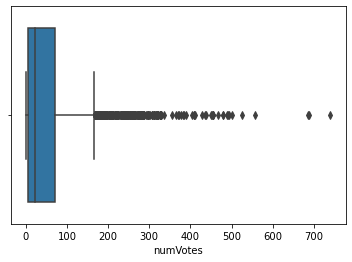

In [205]:
import seaborn as sns

sns.boxplot(data=churn_merge,x=churn_merge['numVotes'])

f) Utilizando o z-score, calcule quantos outliers existem para a lista de colunas abaixo.

In [206]:
from scipy import stats
out_cols=['numVotes', 
       'vote_count', 'qt_dias_diff_vote_min', 'qt_dias_diff_vote_max',
       'qt_dias_diff_vote_median', 'likes_mean', 'likes_min', 'likes_max',
       'dislikes_mean', 'dislikes_min', 'dislikes_max',
       'qt_dias_diff_comment_min', 'qt_dias_diff_comment_max',
       'qt_dias_diff_comment_median', 'commentId_count']

In [207]:
for col in out_cols:
    z=np.abs(stats.zscore(churn_merge[col]))
    print(col, churn_merge[z>3].shape)

numVotes (89, 23)
vote_count (0, 23)
qt_dias_diff_vote_min (66, 23)
qt_dias_diff_vote_max (121, 23)
qt_dias_diff_vote_median (84, 23)
likes_mean (68, 23)
likes_min (96, 23)
likes_max (88, 23)
dislikes_mean (73, 23)
dislikes_min (42, 23)
dislikes_max (104, 23)
qt_dias_diff_comment_min (97, 23)
qt_dias_diff_comment_max (106, 23)
qt_dias_diff_comment_median (82, 23)
commentId_count (0, 23)


Para a variável numVotes, vamos eliminar os registros outliers para não adicionar no nosso modelos casos como esse que podem indicar algum erro.

In [208]:
z=np.abs(stats.zscore(churn_merge.numVotes))
churn_merge = churn_merge[z<3]

Para as demais, vamos substituir os outliers pelos limites inferiores e superiores.

In [209]:
out_cols=[ 'qt_dias_diff_vote_min', 'qt_dias_diff_vote_max',
       'qt_dias_diff_vote_median', 'likes_mean', 'likes_min', 'likes_max',
       'dislikes_mean', 'dislikes_min', 'dislikes_max',
       'qt_dias_diff_comment_min', 'qt_dias_diff_comment_max',
       'qt_dias_diff_comment_median']
for col in out_cols:
    lower_bound = churn_merge[col].mean()-3*churn_merge[col].std()
    upper_bound = churn_merge[col].mean()+3*churn_merge[col].std()
    churn_merge.loc[ churn_merge[col]<lower_bound, col] = int(lower_bound)
    churn_merge.loc[(churn_merge[col]>upper_bound), col] = int(upper_bound)

In [210]:
churn_merge.describe(percentiles=[0.01,0.1,0.25,0.50,0.75,0.90,0.99])

,employee,numVotes,stillExists,vote_mean,vote_mode,vote_min,vote_max,vote_count,qt_dias_diff_vote_min,qt_dias_diff_vote_max,...,likes_mean,likes_min,likes_max,dislikes_mean,dislikes_min,dislikes_max,qt_dias_diff_comment_min,qt_dias_diff_comment_max,qt_dias_diff_comment_median,commentId_count
count,4064.000000,4064.000000,4064.000000,4064.000000,4064.000000,4064.000000,4064.000000,3683.000000,4064.000000,4064.000000,...,4064.000000,4064.000000,4064.000000,4064.000000,4064.000000,4064.000000,4064.000000,4064.000000,4064.000000,2553.000000
mean,192.518455,45.640994,0.852608,2.949092,2.981053,1.859744,3.765748,50.047244,9.157972,148.462106,...,6.621822,1.675689,13.477362,1.135128,0.103346,3.330217,33.290108,145.930856,102.120325,13.634548
std,206.118146,57.645434,0.354540,0.596316,0.789037,0.869260,0.485830,59.709085,17.706919,125.680774,...,4.231692,2.515155,9.533752,1.048029,0.458624,3.942949,46.409744,93.598221,70.456009,21.849711
min,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
1%,2.000000,1.000000,0.000000,1.159813,1.000000,1.000000,2.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000,3.000000,1.000000
10%,19.000000,2.000000,0.000000,2.142857,2.000000,1.000000,3.000000,3.000000,1.000000,13.000000,...,1.500000,0.000000,3.000000,0.000000,0.000000,0.000000,3.000000,23.000000,16.000000,1.000000
25%,51.000000,6.000000,1.000000,2.705882,3.000000,1.000000,4.000000,8.000000,1.000000,45.000000,...,4.000000,0.000000,8.000000,0.333333,0.000000,1.000000,10.000000,97.750000,64.000000,2.000000
50%,131.000000,20.000000,1.000000,3.000000,3.000000,2.000000,4.000000,23.000000,3.000000,130.000000,...,6.771111,1.000000,12.000000,1.206733,0.000000,2.000000,17.000000,139.000000,94.000000,6.000000
75%,244.000000,65.000000,1.000000,3.266667,3.000000,2.000000,4.000000,71.000000,7.000000,207.000000,...,6.771111,1.000000,15.000000,1.206733,0.000000,3.000000,28.000000,165.000000,116.125000,16.000000
90%,469.700000,133.000000,1.000000,3.750000,4.000000,3.000000,4.000000,141.000000,24.000000,300.000000,...,12.177273,4.000000,27.000000,2.222222,0.000000,9.000000,93.000000,273.000000,195.000000,33.000000


## Fim! 

Dataset pronto e limpo! Nas próximas aulas aprenderemos a como enriquecer os dados, criando dados novos a partir dos dados que já temos.

In [211]:
churn_merge.head()

,employee,companyAlias,numVotes,lastParticipationDate,stillExists,vote_mean,vote_mode,vote_min,vote_max,vote_count,...,likes_mean,likes_min,likes_max,dislikes_mean,dislikes_min,dislikes_max,qt_dias_diff_comment_min,qt_dias_diff_comment_max,qt_dias_diff_comment_median,commentId_count
0,512,56aec740f1ef260003e307d6,4,2017-02-23 11:48:04,1,2.000000,1.0,1.0,3.0,3.0,...,7.500000,6.0,9.0,1.000000,0.0,2.0,2.0,30.0,16.0,2.0
1,2,56aec740f1ef260003e307d6,72,2017-03-17 00:00:00,1,2.239437,1.0,1.0,4.0,71.0,...,5.428571,0.0,12.0,4.785714,0.0,12.0,43.0,399.0,267.0,14.0
2,487,56aec740f1ef260003e307d6,14,2016-11-19 14:02:14,0,3.181818,3.0,2.0,4.0,22.0,...,6.000000,6.0,6.0,0.000000,0.0,0.0,22.0,22.0,22.0,1.0
3,3,56aec740f1ef260003e307d6,22,2017-02-16 00:00:00,1,3.476190,4.0,2.0,4.0,21.0,...,3.333333,0.0,14.0,0.888889,0.0,4.0,6.0,376.0,239.0,9.0
4,4,56aec740f1ef260003e307d6,195,2017-03-20 00:00:00,1,3.860825,4.0,1.0,4.0,194.0,...,7.500000,1.0,29.0,1.000000,0.0,4.0,33.0,271.0,107.0,10.0


Vamos salvar os datasets!

In [212]:
churn_merge.to_csv('churn_merge.csv',sep=',',index=False)
# df_comment_interactions.to_csv('comment_interactions.csv',sep=',',index=False)
# comments_clean_anonimized.to_csv('comments_clean_anonimized.csv',sep=',',index=False)
# votes.to_csv('data/votes.csv',sep=',',index=False)